# 1.load data

In [2]:
# import module
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

## 1.1 original data

In [3]:
# 读取原始数据

vehicle_n = 22
static_n = 21
refer_n = 12

mob = [] # 移动站数据
for i in range(vehicle_n):
    mob.append(pd.read_csv("移动设备数据/Nanjing_mobile_" + str(i) + ".csv"))
    mob[i] = mob[i].dropna()[['time', 'pm2d5', 'lat', 'lon', 'tmp', 'hmd', 'pm10']]

# stat = [] # 静态站数据
# for i in range(static_n):
#     stat.append(pd.read_csv("固定设备数据/Nanjing_static_" + str(i) + ".csv"))
#     stat[i] = stat[i].dropna()[['time', 'pm2d5', 'lat', 'lon', 'tmp', 'hmd']]

# ref = [] # 参考站数据
# for i in range(refer_n):
#     ref.append(pd.read_csv("标准站数据/Nanjing_refer_" + str(i) + ".csv"))
#     ref[i] = ref[i].dropna()[['time', 'pm2d5', 'lat', 'lon']] # ref9国控站没有温湿度，其他都有，原始词条数据

In [4]:
# 去除一些比较极端的值，限定在（5 ～ 300）#
for i in range(vehicle_n):
    mob[i] = mob[i].loc[(mob[i].pm2d5 > 5) & (mob[i].pm2d5 < 300)]
# for i in range(refer_n):
#     ref[i] = ref[i].loc[(ref[i].pm2d5 > 5) & (ref[i].pm2d5 < 300)] # ref没有温湿度

In [49]:
mob_tot = pd.concat(mob, keys=[i for i in range(22)])

In [50]:
mob_tot

time      pm2d5        lat         lon        tmp  \
0  325     2022-04-01 05:25:00  31.962222  31.997640  118.741550   8.511111   
   326     2022-04-01 05:26:00  32.816500  31.997640  118.741550   8.810500   
   327     2022-04-01 05:27:00  32.733500  31.997650  118.741548   9.143500   
   328     2022-04-01 05:28:00  32.482222  31.997713  118.741501   9.396667   
   329     2022-04-01 05:29:00  32.066000  31.997512  118.741562   9.694000   
...                        ...        ...        ...         ...        ...   
21 351362  2022-11-30 23:55:00   5.217000  32.012685  118.761663  18.619500   
   351363  2022-11-30 23:56:00   5.883000  32.012699  118.761680  19.160000   
   351364  2022-11-30 23:57:00   7.849500  32.012719  118.761672  19.684500   
   351365  2022-11-30 23:58:00   9.533500  32.012683  118.761624  20.207000   
   351366  2022-11-30 23:59:00   7.157500  32.012669  118.761608  20.723000   

                 hmd       pm10  
0  325     31.985556  38.666667  
   326     34.674500  39.767500  
   327     36.582500  40.216500  
   328     37.433333  39.852222  
   329     38.002000  39.132000  
...              ...        ...  
21 351362  46.149500   6.167000  
   351363  45.238000   6.783000  
   351364  44.480000   8.333000  
   351365  43.799000  10.808000  
   351366  43.152000   8.096000  

[2291097 rows x 7 columns]

In [6]:
## 所有mobile LCS的测量表现 ##
## LCS #11，#12，#17. 的数据较为完整，#1, #0, #7，#11，#14，#15，#21也不错，#6 缺失最多只有一个星期 ##
from plotly import graph_objects as go
from plotly.subplots import make_subplots
from plotly_resampler import register_plotly_resampler

register_plotly_resampler(mode='auto')

fig = go.Figure()

## 描出所有resample数据
for i in range(22):
        fig.add_trace(  
                dict(name="mob#" + str(i), 
                showlegend=True),  ## 没有的话legend不显示       
                hf_x=mob[i].time,
                hf_y=mob[i].pm2d5)


fig.update_layout(
            title_text="PM2.5 tendency of all mob", #Add a chart title·
            title_font_family="Times New Roman",
            title_font_size = 20,
            title_font_color="darkblue", #Specify font color of the title
            title_x=0.5, #Specify the title position
            yaxis_title='PM2.5 concentration',
            # legend=dict(orientation="h", y=1.1, xanchor="left", x=0)
            )


fig

FigureWidgetResampler({
    'data': [{'name': '<b style="color:sandybrown">[R]</b> mob#0 <i style="color:#fc9944">~6h</i>',
              'showlegend': True,
              'type': 'scatter',
              'uid': 'e7197d8c-33f4-4851-abb0-1fe0e782b410',
              'x': array([datetime.datetime(2022, 4, 1, 5, 25),
                          datetime.datetime(2022, 4, 1, 5, 47),
                          datetime.datetime(2022, 4, 1, 8, 8), ...,
                          datetime.datetime(2022, 11, 30, 10, 22),
                          datetime.datetime(2022, 11, 30, 15, 26),
                          datetime.datetime(2022, 11, 30, 15, 46)], dtype=object),
              'y': array([31.96222222, 29.567     , 39.25      , ..., 12.113     , 40.1835    ,
                          19.19416667])},
             {'name': '<b style="color:sandybrown">[R]</b> mob#1 <i style="color:#fc9944">~6h</i>',
              'showlegend': True,
              'type': 'scatter',
              'uid': '2656c038

In [28]:
# 8个月数据各个LCS的数据在时序上的覆盖率 
full_index = pd.date_range(start='2022-04-01 00:00:00', end='2022-12-01 00:00:00', freq='T')
df = []
for i in range(22):
    df.append(len(mob[i])/len(full_index))

df = pd.DataFrame(df,columns=['rate'])
df.sort_values('rate', ascending=False)

,rate
11,0.668617
12,0.573313
17,0.504900
7,0.459399
16,0.427392
4,0.349652
1,0.334343
2,0.332268
3,0.325816
0,0.303713


In [4]:
## 所有ref pm2.5 时序 ##

from plotly import graph_objects as go
from plotly.subplots import make_subplots
from plotly_resampler import register_plotly_resampler

register_plotly_resampler(mode='auto')

fig1 = go.Figure()

## 描出所有resample数据
for i in range(refer_n):
        fig1.add_trace(  
                dict(name="ref#" + str(i), 
                showlegend=True),  ## 没有的话legend不显示       
                hf_x=ref[i].time,
                hf_y=ref[i].pm2d5)


fig1.update_layout(
            title_text="PM2.5 tendency of all ref", #Add a chart title·
            title_font_family="Times New Roman",
            title_font_size = 20,
            title_font_color="darkblue", #Specify font color of the title
            title_x=0.5, #Specify the title position
            yaxis_title='PM2.5 concentration',
            # legend=dict(orientation="h", y=1.1, xanchor="left", x=0)
            )


fig1

FigureWidgetResampler({
    'data': [{'name': '<b style="color:sandybrown">[R]</b> ref#0 <i style="color:#fc9944">~6h</i>',
              'showlegend': True,
              'type': 'scatter',
              'uid': '98c36739-2d23-4ee5-9593-fc552f6438a2',
              'x': array([datetime.datetime(2022, 4, 1, 0, 10),
                          datetime.datetime(2022, 4, 1, 3, 55),
                          datetime.datetime(2022, 4, 1, 10, 0), ...,
                          datetime.datetime(2022, 11, 30, 11, 15),
                          datetime.datetime(2022, 11, 30, 20, 55),
                          datetime.datetime(2022, 11, 30, 23, 55)], dtype=object),
              'y': array([ 9.096, 39.97 , 47.42 , ..., 29.428,  5.063, 27.05 ])},
             {'name': '<b style="color:sandybrown">[R]</b> ref#1 <i style="color:#fc9944">~6h</i>',
              'showlegend': True,
              'type': 'scatter',
              'uid': '6d055f14-065a-4747-af6c-8cec1e7a57f8',
              'x': array

In [19]:
# 8个月数据各个ref的数据在时序上的覆盖率 
full_index = pd.date_range(start='2022-04-01 00:00:00', end='2022-12-01 00:00:00', freq='5T')
df = []
for i in range(11):
    df.append(len(ref[i])/len(full_index))

df = pd.DataFrame(df,columns=['rate'])
df.sort_values('rate', ascending=False)

,rate
1,0.978441
4,0.947690
8,0.931695
5,0.925049
10,0.923470
3,0.923328
0,0.904259
6,0.900616
7,0.887510
2,0.869409


### 1.1.1 stats_analysis

In [5]:
# 白噪声检验 #
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.stats.diagnostic import acorr_ljungbox

np.random.seed(123)

white_noise=np.random.standard_normal(size=100)

# 不再指定boxpierce参数，近返回QLB统计量检验结果
# 同时设置lags参数为一个列表，相应只返回对应延迟阶数的检验结果
res = acorr_ljungbox(mob[12].pm2d5, lags=[6,12,24], return_df=True)
print(res)

         lb_stat  lb_pvalue
6   9.500004e+05        0.0
12  1.819797e+06        0.0
24  3.497850e+06        0.0


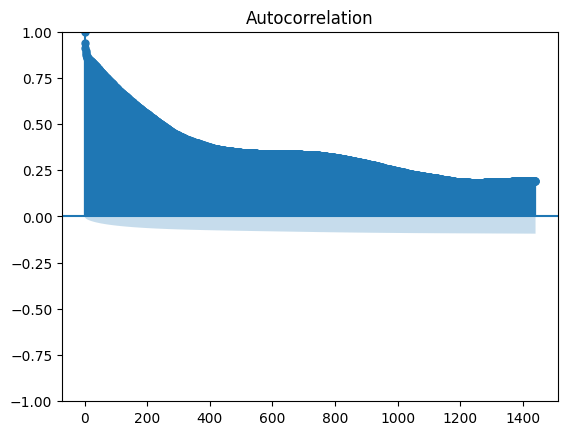

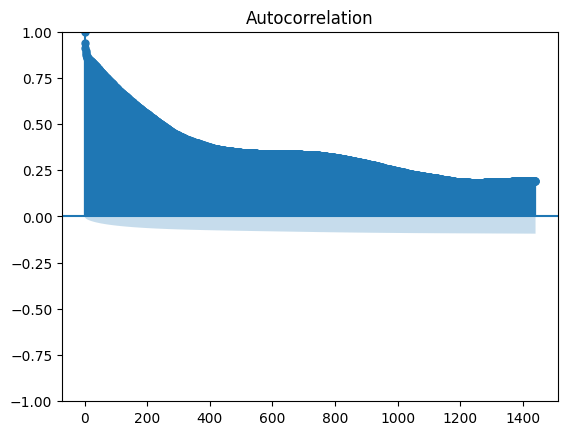

In [6]:
from statsmodels.graphics.tsaplots import plot_acf
 
plot_acf(mob[12].pm2d5, lags = 1440)

## 1.2 rendezvous data

In [20]:
# 写入文件
# import pickle
# with open('rndzvs_df_100m.pkl', 'wb') as file:
#     pickle.dump(rndzvs_df, file)

# 读取文件
rndzvs_df = []
with open('rndzvs_df_200m.pkl', 'rb') as file:
    rndzvs_df = pd.read_pickle(file)

In [21]:
# mob_selected = [11, 12, 17, 7, 16, 4, 2, 3, 1, 0, 10]
df = rndzvs_df[12]
df['error'] = df['pm2d5'] - df['ref_pm2d5']
df

,time,pm2d5,lat,lon,tmp,hmd,street,ref_pm2d5,error
446,2022-04-01 07:26:00,16.533000,32.013193,118.807746,9.556500,37.681500,"(1474897497, 1474897534, 0)",30.234,-13.701000
447,2022-04-01 07:27:00,42.400500,32.013220,118.807710,9.870000,47.953000,"(1474897497, 1474897534, 0)",30.234,12.166500
448,2022-04-01 07:28:00,44.854500,32.013205,118.807730,10.111500,50.585500,"(1474897497, 1474897534, 0)",30.234,14.620500
449,2022-04-01 07:29:00,43.513158,32.013158,118.807782,10.346316,51.402105,"(1474897497, 1474897534, 0)",30.234,13.279158
450,2022-04-01 07:30:00,43.566500,32.013135,118.807827,10.536500,51.695000,"(1474897497, 1474897534, 0)",30.234,13.332500
...,...,...,...,...,...,...,...,...,...
351060,2022-11-30 18:53:00,15.666500,32.012492,118.807637,19.500000,19.949500,"(1474897497, 1474897546, 0)",14.670,0.996500
351061,2022-11-30 18:54:00,15.861667,32.012489,118.807670,19.426667,20.000000,"(1474897497, 1474897546, 0)",14.670,1.191667
351062,2022-11-30 18:55:00,17.870909,32.012496,118.807598,19.400000,20.093636,"(1474897497, 1474897546, 0)",14.670,3.200909
351063,2022-11-30 18:56:00,16.200000,32.012939,118.807176,19.313500,20.104500,"(1474897497, 1474897546, 0)",14.754,1.446000


### Some statistics (optional)

In [8]:
# 计算误差百分比

for i in range(vehicle_n):
    rndzvs_df[i]['error_%'] = abs(rndzvs_df[i]['error']) / rndzvs_df[i]['ref_pm2d5']

In [58]:
# 所有车的平均误差，不同程度误差的样本占比 #
# R方衡量x和y的接近程度，PCC衡量的是x和y的变化趋势是否相同。R方是不对称关系，PCC是对称关系 #
# mape, wmape, smape -- https://medium.com/@vinitkothari.24/time-series-evaluation-metrics-mape-vs-wmape-vs-smape-which-one-to-use-why-and-when-part1-32d3852b4779#
from sklearn.metrics import r2_score
err_prcnt = 0.1
err_abs = 10
for i in range(vehicle_n):
    rmse = np.sqrt((rndzvs_df[i]['error'] ** 2).mean())
    pcc = rndzvs_df[i]['pm2d5'].corr(rndzvs_df[i]['ref_pm2d5'])
    mape = rndzvs_df[i]['error_%'].mean()
    wmape = rndzvs_df[i]['error'].sum() / rndzvs_df[i]['ref_pm2d5'].sum()
    # 计算R^2
    # r_squared = r2_score(rndzvs_df[i]['ref_pm2d5'], rndzvs_df[i]['pm2d5'])


    error_10 = len(rndzvs_df[i][rndzvs_df[i]['error_%'] > err_prcnt])
    error_tot = len(rndzvs_df[i])
    print('lcs{}: MAE {:.2f}, RMSE {:.2f}, PCC {:.2f}, mape {:.2f}, wmape {:.2f}'.format(i, rndzvs_df[i].mean(numeric_only=True)['error'], rmse, pcc, mape, wmape) +
           ', and {}/{} ({}%) points have {}% more error'.format(error_10, error_tot, int(error_10/error_tot * 100), err_prcnt * 100) +
           ', and {}/{} ({}%) points have {} more error'.format(len(rndzvs_df[i][rndzvs_df[i]['error'] > err_abs] ),
                                                                 error_tot, int(len(rndzvs_df[i][rndzvs_df[i]['error'] > err_abs])/error_tot * 100), err_abs)
           )
    


lcs0: MAE 9.87, RMSE 16.01, PCC 0.62, mape 0.52, wmape 0.38, and 4488/5454 (82%) points have 10.0% more error, and 2102/5454 (38%) points have 10 more error
lcs1: MAE 8.30, RMSE 10.56, PCC 0.67, mape 0.52, wmape 0.41, and 3330/3968 (83%) points have 10.0% more error, and 1298/3968 (32%) points have 10 more error
lcs2: MAE 8.81, RMSE 12.67, PCC 0.58, mape 0.45, wmape 0.36, and 4335/5306 (81%) points have 10.0% more error, and 1815/5306 (34%) points have 10 more error
lcs3: MAE 9.04, RMSE 11.70, PCC 0.74, mape 0.48, wmape 0.36, and 4809/5882 (81%) points have 10.0% more error, and 2188/5882 (37%) points have 10 more error
lcs4: MAE 12.82, RMSE 16.22, PCC 0.66, mape 0.89, wmape 0.60, and 1685/1889 (89%) points have 10.0% more error, and 1037/1889 (54%) points have 10 more error
lcs5: MAE 14.03, RMSE 17.29, PCC 0.67, mape 1.07, wmape 0.75, and 905/979 (92%) points have 10.0% more error, and 569/979 (58%) points have 10 more error
lcs6: MAE 23.09, RMSE 23.13, PCC 0.27, mape 1.36, wmape 1.36

In [10]:
## 标签率
for i in range(vehicle_n):
    print('lcs{} label rate: {}/{}, {:.2f}%'.format(i, len(rndzvs_df[i]), len(mob[i]), len(rndzvs_df[i])/len(mob[i])*100))

lcs0 label rate: 5454/106015, 5.14%
lcs1 label rate: 3968/110417, 3.59%
lcs2 label rate: 5306/114541, 4.63%
lcs3 label rate: 5882/113311, 5.19%
lcs4 label rate: 1889/116484, 1.62%
lcs5 label rate: 979/76526, 1.28%
lcs6 label rate: 27/11180, 0.24%
lcs7 label rate: 211/160584, 0.13%
lcs8 label rate: 5268/64899, 8.12%
lcs9 label rate: 915/52723, 1.74%
lcs10 label rate: 7163/101960, 7.03%
lcs11 label rate: 7437/232950, 3.19%
lcs12 label rate: 33849/197173, 17.17%
lcs13 label rate: 5957/88688, 6.72%
lcs14 label rate: 1415/41775, 3.39%
lcs15 label rate: 1245/34684, 3.59%
lcs16 label rate: 8863/142995, 6.20%
lcs17 label rate: 1049/174109, 0.60%
lcs18 label rate: 575/68558, 0.84%
lcs19 label rate: 10568/54394, 19.43%
lcs20 label rate: 2782/68848, 4.04%
lcs21 label rate: 964/101255, 0.95%


In [11]:
err_prcnt = 0.1
err_abs = 10
for i in range(22):
    rndzvs_df[i]['error_%'] = abs(rndzvs_df[i]['error']) / rndzvs_df[i]['ref_pm2d5']

In [32]:
rndzvs_df_tot = pd.concat(rndzvs_df, keys=[i for i in range(22)])
rndzvs_df_tot

time    pm2d5        lat         lon      tmp  \
0  411     2022-04-01 06:51:00  37.0335  32.026038  118.779830  14.5015   
   412     2022-04-01 06:52:00  37.7665  32.029778  118.780759  14.5585   
   415     2022-04-01 06:55:00  36.3670  32.038357  118.782135  14.6985   
   416     2022-04-01 06:56:00  36.5000  32.042450  118.782726  14.7015   
   439     2022-04-01 07:19:00  37.5330  32.041940  118.782551  15.6015   
...                        ...      ...        ...         ...      ...   
21 344683  2022-11-26 08:36:00  42.5830  32.021467  118.824685  18.7735   
   344687  2022-11-26 08:40:00  40.4500  32.021316  118.826535  19.0000   
   344688  2022-11-26 08:41:00  43.2840  32.020905  118.825255  19.0420   
   344689  2022-11-26 08:42:00  43.1990  32.015966  118.824762  19.1000   
   344690  2022-11-26 08:43:00  46.5500  32.014825  118.824683  19.1750   

               hmd                        street  ref_pm2d5    error   error_%  
0  411     36.1035   (1068742569, 4420129292, 0)     37.418   0.3845  0.010276  
   412     35.9450   (3303988132, 4414643356, 0)     37.418   0.3485  0.009314  
   415     35.3470    (771184498, 4415893516, 0)     24.505  11.8620  0.484064  
   416     35.2905  (1038854215, 10951736053, 0)     25.173  11.3270  0.449966  
   439     33.8065  (1038854215, 10951736053, 0)     27.844   9.6890  0.347974  
...            ...                           ...        ...      ...       ...  
21 344683  59.2000   (4219267484, 4219268195, 0)     27.784  14.7990  0.532645  
   344687  59.9170   (4219268252, 9308122931, 0)     27.784  12.6660  0.455874  
   344688  60.2720   (9308122931, 9609170511, 0)     30.184  13.1000  0.434005  
   344689  60.5150   (7232707224, 9609170518, 0)     30.184  13.0150  0.431189  
   344690  60.7600   (7232707224, 9609170518, 0)     30.184  16.3660  0.542208  

[111766 rows x 10 columns]

In [20]:
# 计算数值分布，并转换为百分比格式
distribution_percent = rndzvs_df[1][rndzvs_df[1]['error_%'] > 0.1]['pm2d5'].value_counts(normalize=True) * 100

# 打印百分比分布
print(distribution_percent)



pm2d5
16.766500    0.15015
23.666500    0.12012
17.733500    0.12012
37.033500    0.12012
26.000000    0.12012
              ...   
18.291500    0.03003
18.458000    0.03003
19.088421    0.03003
19.043684    0.03003
17.580000    0.03003
Name: proportion, Length: 3029, dtype: float64


## 1.3 根据相遇绑定ref到完整的mob

In [13]:
# 直接读取即可，无需执行后续步骤 #

# 写入文件
# import pickle
# with open('mob_w_ref.pkl', 'wb') as file:
#     pickle.dump(mob_w_ref, file)

# 读取文件
mob_w_ref = []
with open('mob_w_ref.pkl', 'rb') as file:
    mob_w_ref = pd.read_pickle(file)

筛选出的 mob LCS 与 ref-{100~200}m内覆盖路网 对比

In [4]:
## (多子图多LCS) 筛选出的 mob LCS 与 ref-{100~200}m内覆盖路网 对比
import plotly.graph_objs as go
from plotly_resampler import register_plotly_resampler
from plotly.subplots import make_subplots

register_plotly_resampler(mode='auto')
# create a figure with two subplots
fig = make_subplots(rows=6, cols=2)
mob_selected = [11, 12, 17, 7, 16, 4, 2, 3, 1, 0, 10]

for idx, i in enumerate(mob_selected):
    x_w = mob_w_ref[i].time
    fig.add_trace(dict(mode='markers', name='ref'), hf_x=x_w, hf_y=mob_w_ref[i]['ref_pm2d5'],
                  row=idx//2 + 1, col= idx%2 + 1)
    fig.add_trace(dict(mode='lines+markers', name='lcs #' + str(i)), hf_x=x_w, hf_y=mob_w_ref[i]['pm2d5'],
                  row=idx//2 + 1, col= idx%2 + 1)

# update the layout
fig.update_layout(title='LCS reading vs Ref',
                  height=2000,
                  )

# show the figure
fig


FigureWidgetResampler({
    'data': [{'mode': 'markers',
              'name': '<b style="color:sandybrown">[R]</b> ref <i style="color:#fc9944">~7h</i>',
              'type': 'scatter',
              'uid': '31ba2880-f2ce-45fb-88c6-2aefa4c92d79',
              'x': array([datetime.datetime(2022, 4, 1, 21, 5),
                          datetime.datetime(2022, 4, 1, 21, 9),
                          datetime.datetime(2022, 4, 1, 23, 22), ...,
                          datetime.datetime(2022, 11, 27, 19, 45),
                          datetime.datetime(2022, 11, 27, 19, 46),
                          datetime.datetime(2022, 11, 27, 19, 47)], dtype=object),
              'xaxis': 'x',
              'y': array([20.522, 17.244, 21.368, ..., 33.886, 35.242, 35.242]),
              'yaxis': 'y'},
             {'mode': 'lines+markers',
              'name': '<b style="color:sandybrown">[R]</b> lcs #11 <i style="color:#fc9944">~6h</i>',
              'type': 'scatter',
              'uid': '3b

In [5]:
mob_w_ref = []
for i in range(vehicle_n):
    mob_w_ref.append(pd.merge(mob[i], rndzvs_df[i][['time', 'lat', 'lon', 'ref_pm2d5']], on=['time', 'lat', 'lon'], how='left'))

In [13]:
# 检验正确拼接 #
mob_w_ref[1][mob_w_ref[1].ref_pm2d5.notnull()]

,time,pm2d5,lat,lon,tmp,hmd,ref_pm2d5
353,2022-04-01 10:59:00,29.416500,31.996111,118.782718,28.900000,18.878000,40.322
519,2022-04-01 17:14:00,21.491000,32.026420,118.779782,22.200000,22.857000,19.950
520,2022-04-01 17:15:00,17.891000,32.028340,118.780478,22.200000,22.733500,19.950
521,2022-04-01 17:16:00,19.899500,32.028390,118.780490,22.200000,22.592000,21.244
525,2022-04-01 17:20:00,21.466500,32.039470,118.782386,22.300000,22.971500,13.712
...,...,...,...,...,...,...,...
97905,2022-10-29 11:51:00,24.213333,32.041593,118.782567,27.447778,25.964444,23.519
97927,2022-10-29 12:14:00,14.533500,32.040572,118.782319,27.762000,25.075000,20.205
97928,2022-10-29 12:15:00,15.648333,32.039572,118.782151,27.798333,25.057222,20.205
97933,2022-10-29 12:20:00,16.350500,32.028056,118.780337,27.973000,24.665500,8.747


In [45]:
## (多子图多LCS) 所有 mob LCS 与 ref-{100~200}m内覆盖路网 相遇的统计误差
import plotly.graph_objs as go
from plotly_resampler import register_plotly_resampler
from plotly.subplots import make_subplots

register_plotly_resampler(mode='auto')
# create a figure with two subplots
fig = make_subplots(rows=11, cols=2)

# add a scatter plot to the first subplot
for i in range(vehicle_n):
    x_w = mob_w_ref[i].time
    y_w = mob_w_ref[i]['ref_pm2d5']
    fig.add_trace(go.Scatter(x=x_w, y=y_w, mode='lines+markers', name='ref'),
                  row=i//2 + 1, col= i%2 + 1)
    fig.add_trace(go.Scatter(x=x_w, y=mob_w_ref[i]['pm2d5'], mode='lines+markers', name='lcs # ' + str(i)),
                  row=i//2 + 1, col= i%2 + 1)
    # fig.add_trace(go.Scatter(x=x_ref, y=y_ref, mode='lines+markers', name='ref'),
    #               row=i//2 + 1, col= i%2 + 1,)
    # fig.add_trace(go.Scatter(x=x_lcs, y=y_lcs, mode='lines+markers', name='lcs'), 
    #               row=i//2 + 1, col= i%2 + 1)



# update the layout
fig.update_layout(title='Error trend of all LCS with ref',
                  height=2000,
                  )

# show the figure
fig.show()

In [48]:
mob_w_ref[1][mob_w_ref[1].tmp < 20].pm2d5.mean()

37.6194739519969

In [50]:
## (多子图多LCS) 所有 mob LCS pm2.5 与 湿度 的相关度
# 数据比较正常的：0，8，9，10，13，14，15和倒数那几个都还行#


import plotly.graph_objs as go
from plotly_resampler import register_plotly_resampler
from plotly.subplots import make_subplots

register_plotly_resampler(mode='auto')
# create a figure with two subplots
fig = make_subplots(rows=11, cols=2)

# add a scatter plot to the first subplot
for i in range(vehicle_n):
    x_w = mob_w_ref[i].time
    y_w = mob_w_ref[i]['hmd']
    fig.add_trace(go.Scatter(x=x_w, y=y_w, mode='lines+markers', name='hmd'),
                  row=i//2 + 1, col= i%2 + 1)
    fig.add_trace(go.Scatter(x=x_w, y=mob_w_ref[i]['pm2d5'], mode='lines+markers', name='lcs # ' + str(i)),
                  row=i//2 + 1, col= i%2 + 1)
    # fig.add_trace(go.Scatter(x=x_ref, y=y_ref, mode='lines+markers', name='ref'),
    #               row=i//2 + 1, col= i%2 + 1,)
    # fig.add_trace(go.Scatter(x=x_lcs, y=y_lcs, mode='lines+markers', name='lcs'), 
    #               row=i//2 + 1, col= i%2 + 1)



# update the layout
fig.update_layout(title='Error trend of all LCS with ref',
                  height=2000,
                  )

# show the figure
fig.show()

## 1.4 筛选出的前十个LCS

In [35]:
len(pd.date_range(start='2022-04-01 00:00:00', end='2022-12-01 00:00:00', freq='T'))

351361

In [32]:
mob_selected = [11, 12, 17, 7, 16, 4, 2, 3, 1, 0, 10]
mob_ = []
for i, val in enumerate(mob_selected):
    mob_.append(pd.read_csv("移动设备数据/Nanjing_mobile_" + str(val) + ".csv").dropna()[['time', 'pm2d5', 'lat', 'lon', 'tmp', 'hmd', 'pm10']])

In [5]:
mob_selected = [11, 12, 17, 7, 16, 4, 2, 3, 1, 0, 10]
mob_w_ref_ = []
for i, val in enumerate(mob_selected):
    mob_w_ref_.append(mob_w_ref[val])

In [7]:
mob_w_ref_[0]

,time,pm2d5,lat,lon,tmp,hmd,ref_pm2d5
0,2022-04-01 00:00:00,32.245263,32.007120,118.851580,22.001579,15.849474,NaN
1,2022-04-01 00:01:00,31.584000,32.007107,118.851583,22.000000,15.878500,NaN
2,2022-04-01 00:02:00,31.766500,32.007070,118.851590,21.981500,15.899500,NaN
3,2022-04-01 00:03:00,32.683500,32.007083,118.851590,21.918500,15.929500,NaN
4,2022-04-01 00:04:00,34.717000,32.007120,118.851590,21.900000,15.958000,NaN
...,...,...,...,...,...,...,...
232945,2022-11-30 23:55:00,14.399500,32.013089,118.833968,31.254500,6.017500,NaN
232946,2022-11-30 23:56:00,15.884000,32.013092,118.833968,31.226000,5.963500,NaN
232947,2022-11-30 23:57:00,14.782500,32.013089,118.833964,31.203000,5.910500,NaN
232948,2022-11-30 23:58:00,15.900500,32.013090,118.833968,31.200000,5.889000,NaN


In [13]:
for i, val in enumerate(mob_selected):
    rndzvs_df[val]['error_%'] = abs(rndzvs_df[val]['error']) / rndzvs_df[val]['ref_pm2d5']

In [19]:
err_prcnt = 0.1
err_abs = 10
for _, i in enumerate(mob_selected):
    rmse = np.sqrt((rndzvs_df[i]['error'] ** 2).mean())
    pcc = rndzvs_df[i]['pm2d5'].corr(rndzvs_df[i]['ref_pm2d5'])
    mape = rndzvs_df[i]['error_%'].mean()
    wmape = rndzvs_df[i]['error'].sum() / rndzvs_df[i]['ref_pm2d5'].sum()
    # 计算R^2
    # r_squared = r2_score(rndzvs_df[i]['ref_pm2d5'], rndzvs_df[i]['pm2d5'])


    error_10 = len(rndzvs_df[i][rndzvs_df[i]['error_%'] > err_prcnt])
    error_tot = len(rndzvs_df[i])
    print('lcs{}(label: {}/{}, {:.2f}%): MAE {:.2f}, RMSE {:.2f}, PCC {:.2f}, mape {:.2f}, wmape {:.2f}'.format(i, len(rndzvs_df[i]), len(mob[i]), len(rndzvs_df[i])/len(mob[i])*100,
           rndzvs_df[i].mean(numeric_only=True)['error'], rmse, pcc, mape, wmape) +
           ', and {}/{} ({}%) points have {}% more error'.format(error_10, error_tot, int(error_10/error_tot * 100), err_prcnt * 100) +
           ', and {}/{} ({}%) points have {} more error'.format(len(rndzvs_df[i][rndzvs_df[i]['error'] > err_abs] ),
                                                                 error_tot, int(len(rndzvs_df[i][rndzvs_df[i]['error'] > err_abs])/error_tot * 100), err_abs)
           )

lcs11(label: 7437/234926, 3.17%): MAE 12.11, RMSE 15.01, PCC 0.70, mape 0.85, wmape 0.60, and 6665/7437 (89%) points have 10.0% more error, and 3832/7437 (51%) points have 10 more error
lcs12(label: 33849/201440, 16.80%): MAE 9.26, RMSE 12.29, PCC 0.73, mape 0.54, wmape 0.42, and 28311/33849 (83%) points have 10.0% more error, and 12541/33849 (37%) points have 10 more error
lcs17(label: 1049/177402, 0.59%): MAE 11.66, RMSE 14.44, PCC 0.77, mape 0.70, wmape 0.54, and 931/1049 (88%) points have 10.0% more error, and 569/1049 (54%) points have 10 more error
lcs7(label: 211/161415, 0.13%): MAE 18.57, RMSE 21.30, PCC 0.57, mape 1.03, wmape 0.86, and 209/211 (99%) points have 10.0% more error, and 159/211 (75%) points have 10 more error
lcs16(label: 8863/150169, 5.90%): MAE 8.59, RMSE 11.17, PCC 0.58, mape 0.47, wmape 0.36, and 7259/8863 (81%) points have 10.0% more error, and 2994/8863 (33%) points have 10 more error
lcs4(label: 1889/122854, 1.54%): MAE 12.82, RMSE 16.22, PCC 0.66, mape 0.8

In [18]:
# 10个传感器的平均误差
sum_err = 0
n = 0
for _, i in enumerate(mob_selected):
    sum_err += abs(rndzvs_df[i]['error']).sum()
    n += len(rndzvs_df[i])
print(sum_err / n)

9.586406656777704


In [13]:
df_train = pd.read_pickle('./my data/train/train'+ str(12)+ '_' + str(9)+'.pkl')
df_train

,Unnamed: 0,time,pm2d5,lat,lon,tmp,hmd,ref_pm2d5,weight
123401,123402,2022-09-01 06:54:00,69.000000,32.01241,118.80795,20.3000,75.6000,31.678,1
123402,123403,2022-09-01 06:55:00,75.116500,32.01241,118.80795,20.5815,78.7010,31.678,1
123403,123404,2022-09-01 06:56:00,76.567000,32.01241,118.80795,20.9765,81.6260,32.540,1
123404,123405,2022-09-01 06:57:00,82.183500,32.01241,118.80795,21.2630,82.9235,32.540,1
123405,123406,2022-09-01 06:58:00,80.700500,32.01241,118.80795,21.4715,83.5570,32.540,1
...,...,...,...,...,...,...,...,...,...
131777,131778,2022-09-14 22:37:00,11.550000,31.98312,118.79977,25.3860,71.1000,0.000,0
131778,131779,2022-09-14 22:38:00,11.183500,31.98312,118.79977,25.4000,71.0850,0.000,0
131779,131780,2022-09-14 22:39:00,13.017368,31.98312,118.79977,25.4000,71.0000,0.000,0
131780,131781,2022-09-14 22:40:00,12.250500,31.98312,118.79977,25.4000,71.0590,0.000,0


## 1.5 NaN的GT置0 & GT权重设置 & 插值（optional）

In [6]:
mob_w_ref = []
with open('mob_w_ref.pkl', 'rb') as file:
    mob_w_ref = pd.read_pickle(file)

In [77]:
num = 11
mob_test = mob_w_ref[num]
mob_test = mob_test.loc[~mob_test.time.duplicated(keep='first')] # 去除重复时间戳
mob_test['weight'] = mob_test['ref_pm2d5'].apply(lambda x: 0 if pd.isnull(x) else 1)
mob_test['ref_pm2d5'] = mob_test['ref_pm2d5'].fillna(0)
# 保存完整mob with weight #
mob_test.to_csv('./my data/mob/mob'+str(num)+'.csv')

/tmp/ipykernel_765293/3978582150.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_765293/3978582150.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [34]:
# 补全时间戳，暂时忽略#
# ！似乎没有必要补全所有时间戳，因为填充值的方式有限，对总体训练的影响可能有限（不连续的间隔的影响未知），先直接用mob_w_ref即可 #

mob_test = mob_test.loc[~mob_test.time.duplicated(keep='first')] # 时间戳去重，否则后续不能reindex
mob_test['time'] = pd.to_datetime(mob_test['time']) # merge所需的时间戳格式

start_date = '2022-04-01 00:00:00'
end_date = '2022-11-30 23:59:00'
freq = 'T'  # 5 minutes interval

# Create a date range with the specified start date, end date, and frequency
time_range = pd.date_range(start=start_date, end=end_date, freq=freq)

# Create a dataframe with the complete time range
time_range_df = pd.DataFrame({'time': time_range})

# Merge the existing mob_test dataframe with the time_range_df to add missing timestamps
mob_test = pd.merge(time_range_df, mob_test, on='time', how='left')

# Print the updated mob_test dataframe
mob_test



,time,pm2d5,lat,lon,tmp,hmd,ref_pm2d5
0,2022-04-01 00:00:00,32.245263,32.007120,118.851580,22.001579,15.849474,NaN
1,2022-04-01 00:01:00,31.584000,32.007107,118.851583,22.000000,15.878500,NaN
2,2022-04-01 00:02:00,31.766500,32.007070,118.851590,21.981500,15.899500,NaN
3,2022-04-01 00:03:00,32.683500,32.007083,118.851590,21.918500,15.929500,NaN
4,2022-04-01 00:04:00,34.717000,32.007120,118.851590,21.900000,15.958000,NaN
...,...,...,...,...,...,...,...
351355,2022-11-30 23:55:00,14.399500,32.013089,118.833968,31.254500,6.017500,NaN
351356,2022-11-30 23:56:00,15.884000,32.013092,118.833968,31.226000,5.963500,NaN
351357,2022-11-30 23:57:00,14.782500,32.013089,118.833964,31.203000,5.910500,NaN
351358,2022-11-30 23:58:00,15.900500,32.013090,118.833968,31.200000,5.889000,NaN


In [13]:
# 手动划分数据集 #
mob_test[mob_test.time < '2022-09-01'].to_pickle('./my data/train_12.pkl')
mob_test[(mob_test.time >= '2022-09-01') & (mob_test.time < '2022-10-01')].to_pickle('./my data/val_12.pkl')
mob_test[mob_test.time > '2022-10-01'].to_pickle('./my data/test_12.pkl')

# from sklearn.model_selection import train_test_split

# # Assuming df is your DataFrame and you want a 60% / 20% / 20% split
# train_size = 0.6
# test_size = validation_size = 0.2

# # First split: Separate out the training set
# df_train, df_temp = train_test_split(df, train_size=train_size)

# # Second split: Separate out the testing and validation sets
# df_test, df_validation = train_test_split(df_temp, test_size=0.5)

# # Now you have three dataframes: df_train, df_test, df_validation

In [19]:
# 手动计算测试集原始误差 #
rndzvs_df[11][-1000:].mean(numeric_only=True)['error']

13.27523235482865

# Sensorformer

### 训练好的模型校准其他传感器

In [1]:
import pandas as pd
import numpy as np
from sklearn.metrics import mean_absolute_error
import torch
from SensorFormer.SensorFormer.many2many import *
# from importlib import import_module
# SF = import_module('SensorFormer.SensorFormer.many2many')

2024-02-28 12:47:22.174034: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-02-28 12:47:22.219509: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-02-28 12:47:22.913226: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/home/zihao/anaconda3/envs/py11/lib/python3.11/site-packages/requests/__init__.py:102: RequestsDependencyWarning: urllib3 (1.26.8) or chardet (5.2.0)/charset_normalizer (None) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or charde

In [99]:
# 读取测试的传感器数据 #
num = 3
test_dat = pd.read_csv('/home/zihao/PycharmProjects/yucz/Nanjing_extended_data/my data/mob/mob'+ str(num) +'.csv')
feature_names = ['pm2d5', 'hmd', 'tmp', 'weight']
target_names =['ref_pm2d5']

# 将读取的数据转换成列表
test_features = test_dat[feature_names].values.astype(np.float32)
test_target = test_dat[target_names].values.astype(np.float32)

# 切割数据进入data loader，以进行inference
test_dataset = TimeseriesDataset(test_features, test_target, seq_len=12)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size = 1, shuffle = False)

In [100]:
# Inference w mob11 training model#
# mob12 - 8.87(9.26), mob7 - 6.61(18.57), mob16 - 10.65(8.59), mob17 - 7.94(11.66)#
# mob10 - 9.23(9.86), mob2 - 9.85(8.81), mob3 - 9.56(9.04), mob4 - 7.22/lr0.0005, 7.60/0.0003 (12.82) #
device = torch.device("cuda")

best_model = torch.load('SensorFormer/SensorFormer/result/tmp/AdamW_lr0.0003_ep250.pt')
pred,test_loss = test(best_model, device, test_loader)
pred = np.array(pred)
pred_df = all_pred(pred,12)
pred_df = pred_df.apply(lambda row: row.fillna(row.mean()), axis=1)
pred_df['mean'] = pred_df.iloc[:, 0:].mean(axis=1)
    
pred_true = test_target[:pred_df.shape[0],0]
pred_df['true'] = pred_true

# inverse_pred = scaler_y.inverse_transform(pred_df['mean'].values.reshape(-1,1))
# inverse_true = scaler_y.inverse_transform(pred_true.reshape(-1,1))
valid_pred = pred_df[pred_df['true'] != 0]

pred_df.to_csv('SensorFormer/SensorFormer/result/test_mob/mob' + str(num) + '.csv')

print('Test MAE: ', mean_absolute_error(valid_pred.true, valid_pred['mean']))

sum of test loss:  60283.78125 
valid_cnt of test set:  70584.0
Test set: Average loss: 0.8541
Test MAE:  10.237417062038327


In [103]:
valid_pred

,0,1,2,3,4,5,6,7,8,9,10,11,mean,true
80,20.123684,19.760733,19.398668,19.145298,19.167637,19.619186,19.769402,19.834377,20.425411,20.606720,20.377522,20.388241,19.884740,32.714001
81,19.799347,19.427883,19.167671,19.128662,19.618698,19.766132,19.859694,20.451927,20.620264,20.376661,20.387327,20.160666,19.897078,34.551998
85,19.586311,19.605057,19.755079,20.366356,20.566866,20.333546,20.327217,20.070065,20.122198,20.551044,20.247496,20.033903,20.130428,27.844000
86,19.665197,19.805603,20.358463,20.608883,20.372036,20.378590,20.132864,20.182627,20.441921,20.282341,20.061626,20.138382,20.202378,27.844000
112,20.463556,20.226448,20.026031,20.010204,19.922476,20.451340,20.334148,20.765118,20.724606,20.794086,20.470600,20.139887,20.360708,27.844000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112548,39.211994,39.213337,39.240742,40.100269,40.062572,39.781361,39.086330,38.762302,38.685448,38.279156,38.437809,38.140686,39.083501,85.481003
112572,38.498356,38.315277,38.360317,38.522572,38.731403,38.745640,39.349018,39.345043,39.353931,39.694210,40.404118,41.247108,39.213916,85.019997
112573,38.469498,38.510616,38.687962,38.893642,38.902039,39.507839,39.503521,39.515785,39.854244,40.750797,41.410927,42.452599,39.704956,85.019997
112578,39.312397,39.313847,39.341621,39.676174,40.265446,41.233452,42.263531,40.756962,41.598202,41.523739,41.444080,41.364025,40.674456,93.891998


### 评估 inference 效果

In [101]:
# 加载需要评估的数据 #
import pandas as pd

# num = 10
res = pd.read_csv("SensorFormer/SensorFormer/result/test_mob/mob" + str(num) + ".csv")

df = mob_w_ref[num][:-11]
df = df.loc[~df.time.duplicated(keep='first')] # 去掉重复时间戳

In [102]:
from plotly import graph_objects as go
from plotly_resampler import register_plotly_resampler

register_plotly_resampler(mode='auto')

fig = go.Figure()

## 描出所有resample数据

fig.add_trace(  
        dict(name="ref mob#" + str(num), 
        mode='lines',
        showlegend=True),  ## 没有的话legend不显示       
        hf_x=df[df.ref_pm2d5 > 0].time,
        hf_y=res[res.true > 0]['true'])

fig.add_trace(  
        dict(name="cal mob#" + str(num), 
        mode='lines',
        showlegend=True),  ## 没有的话legend不显示       
        hf_x=df.time,
        hf_y=res['mean'])

fig.add_trace(  
        dict(name="ori mob#" + str(num), 
        mode='lines',
        showlegend=True),  ## 没有的话legend不显示       
        hf_x=df.time,
        hf_y=df.pm2d5)

fig.update_layout(
            title_text="calibrated values vs ref values", #Add a chart title·
            title_font_family="Times New Roman",
            title_font_size = 20,
            title_font_color="darkblue", #Specify font color of the title
            title_x=0.5, #Specify the title position
            yaxis_title='PM2.5 concentration',
            # legend=dict(orientation="h", y=1.1, xanchor="left", x=0)
            )


fig

FigureWidgetResampler({
    'data': [{'mode': 'lines',
              'name': '<b style="color:sandybrown">[R]</b> ref mob#3 <i style="color:#fc9944">~5h</i>',
              'showlegend': True,
              'type': 'scatter',
              'uid': 'aec1e722-7ae5-46ac-85b8-c0c5df12d3e2',
              'x': array([datetime.datetime(2022, 4, 1, 7, 0),
                          datetime.datetime(2022, 4, 1, 9, 13),
                          datetime.datetime(2022, 4, 1, 9, 18), ...,
                          datetime.datetime(2022, 11, 16, 9, 16),
                          datetime.datetime(2022, 11, 16, 12, 12),
                          datetime.datetime(2022, 11, 16, 12, 19)], dtype=object),
              'y': array([32.714, 24.854, 37.431, ..., 68.894, 85.02 , 93.892])},
             {'mode': 'lines',
              'name': '<b style="color:sandybrown">[R]</b> cal mob#3 <i style="color:#fc9944">~5h</i>',
              'showlegend': True,
              'type': 'scatter',
              'ui

# 2.StatsForecast (in-sample predicting integrated, very handy)

In [112]:
from statsforecast import StatsForecast
from statsforecast.models import *
from statsforecast.utils import ConformalIntervals

In [6]:
test = rndzvs_df[8][['time', 'pm2d5']]
test['unique_id'] = 8
test.rename(columns={'time': 'ds', 'pm2d5': 'y'}, inplace=True)
test['ds'] = pd.to_datetime(test['ds'])

NameError: name 'rndzvs_df' is not defined

In [116]:
test

,ds,y,unique_id
2024,2022-04-02 09:44:00,35.0340,8
2025,2022-04-02 09:45:00,36.4995,8
2026,2022-04-02 09:46:00,54.9840,8
2027,2022-04-02 09:47:00,37.5835,8
2028,2022-04-02 09:48:00,36.5505,8
...,...,...,...
343727,2022-11-25 16:40:00,37.8830,8
343728,2022-11-25 16:41:00,36.1500,8
345143,2022-11-26 16:16:00,42.6000,8
345144,2022-11-26 16:17:00,42.0000,8


In [14]:
StatsForecast.plot(test, engine='plotly')


/home/yucz21/miniconda3/envs/ox/lib/python3.11/site-packages/statsforecast/core.py:1514: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["unique_id"] = df["unique_id"].astype(uid_dtype)


## 2.1 AutoArima(mild improvement) & holtwinters(not suitable)

In [132]:
# insample prediction is a 1-step ahead prediction, meaning that each prediction is calculated using just the previous value in the sequence #

sf = StatsForecast(
    # models = [, HoltWinters(season_length=0, error_type='A')],
    # models = [SimpleExponentialSmoothingOptimized(prediction_intervals=ConformalIntervals(n_windows=10))],
    models = [AutoARIMA(), AutoRegressive(lags=[10]), AutoCES(model='Z', season_length=4), AutoETS(model='ZMZ', season_length=4), AutoTheta(season_length=4),
              RandomWalkWithDrift(), GARCH()],
    freq = 'T'
)
sf.fit(test)
sf.forecast(h=1, fitted=True) # level=[90]
insample_fcsts_df = sf.forecast_fitted_values()
insample_fcsts_df

/home/yucz21/miniconda3/envs/ox/lib/python3.11/site-packages/statsforecast/arima.py:828: UserWarning:

some AR parameters were fixed: setting transform_pars = False

/home/yucz21/miniconda3/envs/ox/lib/python3.11/site-packages/statsforecast/arima.py:828: UserWarning:

some AR parameters were fixed: setting transform_pars = False



,ds,y,AutoARIMA,AutoRegressive,CES,AutoETS,AutoTheta,RWD,"GARCH(1,1)"
unique_id,,,,,,,,,
8,2022-04-02 09:44:00,35.034000,34.998966,33.159428,37.361042,38.024086,35.034000,NaN,NaN
8,2022-04-02 09:45:00,36.499500,35.180218,33.412064,36.821320,34.577171,25.714069,35.035358,22.300543
8,2022-04-02 09:46:00,54.984001,36.953472,36.598583,35.506691,34.110611,30.937927,36.500858,-8.447220
8,2022-04-02 09:47:00,37.583500,47.150543,33.598934,45.125122,40.694271,41.882690,54.985359,-8.250228
8,2022-04-02 09:48:00,36.550499,39.592846,33.420856,38.649403,44.951057,40.347866,37.584858,-15.120414
...,...,...,...,...,...,...,...,...,...
8,2022-11-25 16:40:00,37.882999,40.333565,38.464985,38.416088,39.749901,40.099148,38.551357,20.956484
8,2022-11-25 16:41:00,36.150002,39.522732,38.994381,38.100990,41.244362,39.543385,37.884357,-1.052251
8,2022-11-26 16:16:00,42.599998,38.177208,38.586315,36.663345,38.950996,37.754177,36.151356,3.965605


In [96]:
test

,ds,y,unique_id
367,2022-04-01 06:07:00,37.9500,5
521,2022-04-01 08:41:00,41.3630,5
522,2022-04-01 08:42:00,41.4585,5
545,2022-04-01 09:05:00,42.5995,5
671,2022-04-01 11:11:00,32.8500,5
...,...,...,...
337468,2022-11-21 08:21:00,43.8830,5
337490,2022-11-21 08:43:00,42.0665,5
337491,2022-11-21 08:44:00,42.1010,5
337492,2022-11-21 08:45:00,42.1330,5


In [45]:
sf.plot(test, insample_fcsts_df, engine='plotly', plot_anomalies=True)

/home/yucz21/miniconda3/envs/ox/lib/python3.11/site-packages/statsforecast/core.py:1514: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [40]:
insample_fcsts_df[insample_fcsts_df.apply(lambda x: x['y'] < x['AutoARIMA-lo-50'] or x['y'] > x['AutoARIMA-hi-50'], axis=1)]

,ds,y,AutoARIMA,AutoARIMA-lo-50,AutoARIMA-hi-50
unique_id,,,,,
5,2022-04-01 06:07:00,37.950001,28.824215,23.037813,34.610619
5,2022-04-01 11:11:00,32.849998,41.349499,35.563095,47.135902
5,2022-04-02 06:20:00,45.516499,28.569830,22.783426,34.356232
5,2022-04-02 11:56:00,29.266500,39.440701,33.654301,45.227104
5,2022-04-03 10:11:00,43.123158,28.407730,22.621326,34.194134
...,...,...,...,...,...
5,2022-11-17 08:27:00,26.549999,81.325035,75.538628,87.111435
5,2022-11-17 17:56:00,32.816502,23.671257,17.884853,29.457661
5,2022-11-18 13:05:00,42.582500,32.452457,26.666054,38.238861


In [133]:
crossvaldation_df = sf.cross_validation(
    df=test,
    h=1,
    n_windows=20,
    fitted=True
  )


In [138]:
crossvaldation_df

,ds,cutoff,y,AutoARIMA
unique_id,,,,
5,2022-11-27 19:49:00,2022-11-27 19:48:00,35.183498,34.612965
5,2022-11-27 19:50:00,2022-11-27 19:49:00,37.316502,34.096588
5,2022-11-27 19:51:00,2022-11-27 19:50:00,33.433498,36.167240
5,2022-11-27 19:52:00,2022-11-27 19:51:00,42.582500,32.401028
5,2022-11-27 19:53:00,2022-11-27 19:52:00,43.834000,41.279495
5,2022-11-27 19:54:00,2022-11-27 19:53:00,43.099499,42.496689
5,2022-11-27 19:55:00,2022-11-27 19:54:00,40.633999,41.785580
5,2022-11-27 19:56:00,2022-11-27 19:55:00,35.866501,39.393620
5,2022-11-27 19:57:00,2022-11-27 19:56:00,38.083500,34.767445


In [137]:
insample_rolled_fcsts_df = sf.cross_validation_fitted_values()
insample_rolled_fcsts_df

,ds,cutoff,y,AutoARIMA
unique_id,,,,
5,2022-04-01 06:07:00,2022-11-17 18:33:00,37.950001,28.587360
5,2022-04-01 08:41:00,2022-11-17 18:33:00,41.362999,36.776943
5,2022-04-01 08:42:00,2022-11-17 18:33:00,41.458500,40.084446
5,2022-04-01 09:05:00,2022-11-17 18:33:00,42.599499,40.176994
5,2022-04-01 11:11:00,2022-11-17 18:33:00,32.849998,41.282722
...,...,...,...,...
5,2022-11-21 08:20:00,2022-11-21 08:45:00,44.966999,50.345585
5,2022-11-21 08:21:00,2022-11-21 08:45:00,43.882999,43.619808
5,2022-11-21 08:43:00,2022-11-21 08:45:00,42.066502,42.568283


# 3.tsai (not convenient for in-sample prediction)

In [3]:
from tsai.all import *
my_setup()

/home/zihao/anaconda3/envs/py11/lib/python3.11/site-packages/torch/cuda/__init__.py:611: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


os              : Linux-5.15.0-89-generic-x86_64-with-glibc2.31
python          : 3.11.4
tsai            : 0.3.8
fastai          : 2.7.13
fastcore        : 1.5.29
torch           : 2.1.2+cu121
device          : 2 gpus (['NVIDIA GeForce RTX 3090', 'NVIDIA GeForce RTX 3090'])
cpu cores       : 24
threads per cpu : 2
RAM             : 251.38 GB
GPU memory      : N/A


In [4]:
# http://tseregression.org/ #
regression_list

['AppliancesEnergy',
 'AustraliaRainfall',
 'BeijingPM10Quality',
 'BeijingPM25Quality',
 'BenzeneConcentration',
 'Covid3Month',
 'FloodModeling1',
 'FloodModeling2',
 'FloodModeling3',
 'HouseholdPowerConsumption1',
 'HouseholdPowerConsumption2',
 'IEEEPPG',
 'LiveFuelMoistureContent',
 'NewsHeadlineSentiment',
 'NewsTitleSentiment']

In [42]:
dsid = 'BeijingPM25Quality' 
X, y, splits = get_regression_data(dsid, split_data=False)

X      - shape: [16966 samples x 9 features x 24 timesteps]  type: memmap  dtype:float64  isnan: 37558
y      - shape: (16966,)  type: memmap  dtype:float64  isnan: 0
splits - n_splits: 2 shape: [11918, 5048]  overlap: False


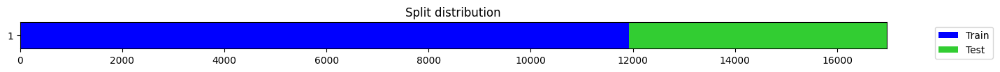

In [43]:
# X includes hourly air pollutants measurments (SO2, NO2, CO and O3), temperature, pressure, dew point, rainfall and windspeed measurments from 12 nationally controlled air quality monitoring sites
# y - pm2.5, 基本上就是用一天的多变量时序去预测一个y，也不知道是下一时刻的值还是当天的平均水平#
check_data(X, y, splits) 

In [49]:
tfms  = [None, [TSRegression()]]
batch_tfms = [TSStandardize(by_sample=True, by_var=True), Nan2Value()] # 对于有缺失值的数据集 Nan2Value() 很重要！！！否则无法正常训练， ref：https://github.com/timeseriesAI/tsai/issues/87
dls = get_ts_dls(X, y, splits=splits, tfms=tfms, batch_tfms=batch_tfms, bs=64)
dls.one_batch()

(TSTensor(samples:64, vars:9, len:24, device=cuda:0, dtype=torch.float32),
 tensor([ 42.,  72.,  68., 274.,  95., 153., 117., 278.,  71., 112.,  81., 150.,
          16., 360.,  29., 213., 126.,  97.,  57.,  45., 152.,  26., 146., 182.,
         178., 184.,  45.,  91.,  13., 222., 114., 163., 177., 131.,  20.,  95.,
         109., 168., 287., 138., 141.,  76.,  77., 160., 501., 131., 137., 105.,
         127., 178.,  50., 391., 193.,  49., 370., 144., 114.,  26., 201.,  63.,
          42., 108., 140., 182.], device='cuda:0'))

In [29]:
dls.c

1

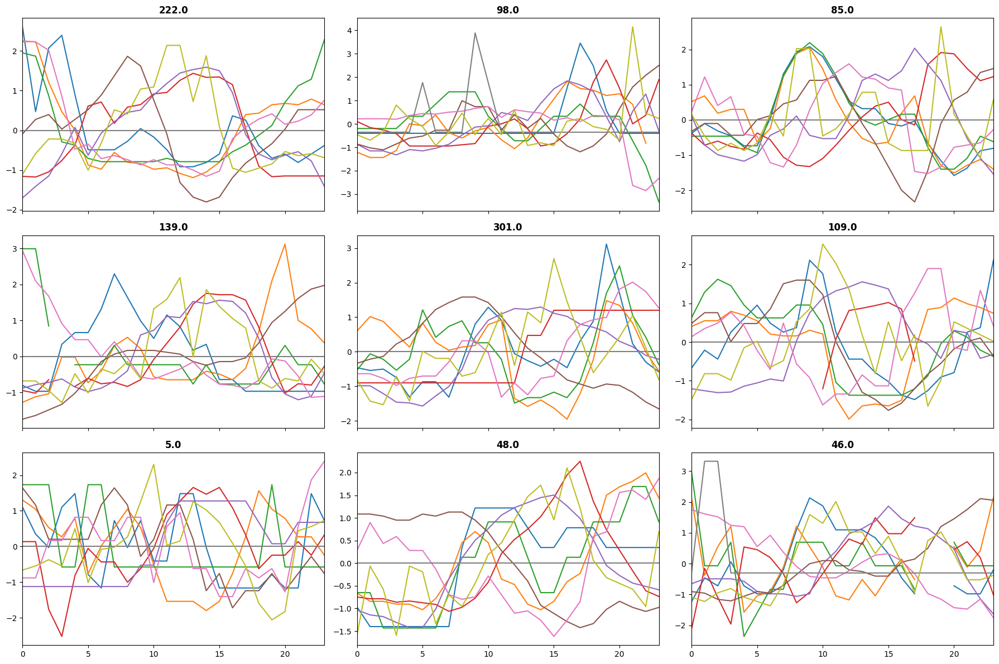

In [45]:
dls.show_batch()

SuggestedLRs(valley=0.05754399299621582)

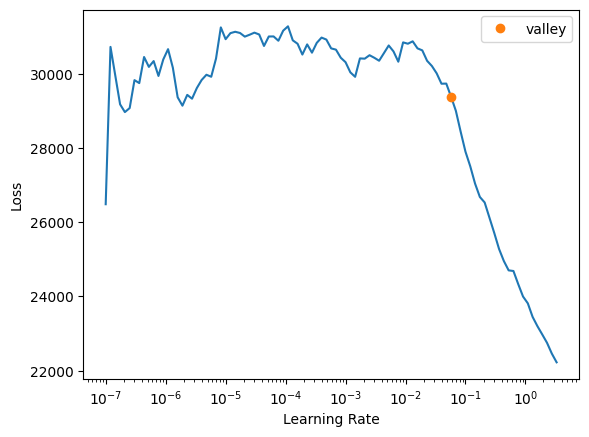

In [50]:
learn = ts_learner(dls, InceptionTime, metrics=[mae, rmse], cbs=ShowGraph())
learn.lr_find()

epoch,train_loss,valid_loss,mae,_rmse,time
0,8751.768555,7854.813965,64.795784,88.627380,00:04
1,5854.503906,8904.501953,71.667152,94.363670,00:05
2,5282.357910,9382.773438,67.723328,96.864723,00:04
3,5109.722168,7627.462891,58.158733,87.335350,00:04
4,5121.928223,8212.077148,60.498566,90.620499,00:04
5,4746.395020,15612.331055,87.568573,124.949318,00:04
6,4815.000977,15907.236328,92.120422,126.123894,00:04
7,4606.591797,7883.670410,58.535774,88.790047,00:05
8,4589.541016,8113.306641,58.123169,90.073898,00:04
9,4595.549316,7917.910645,56.642029,88.982651,00:05


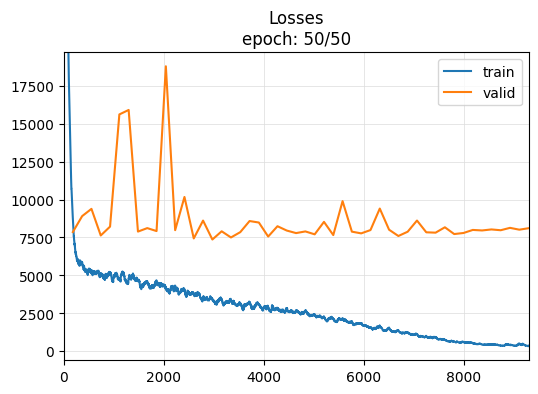

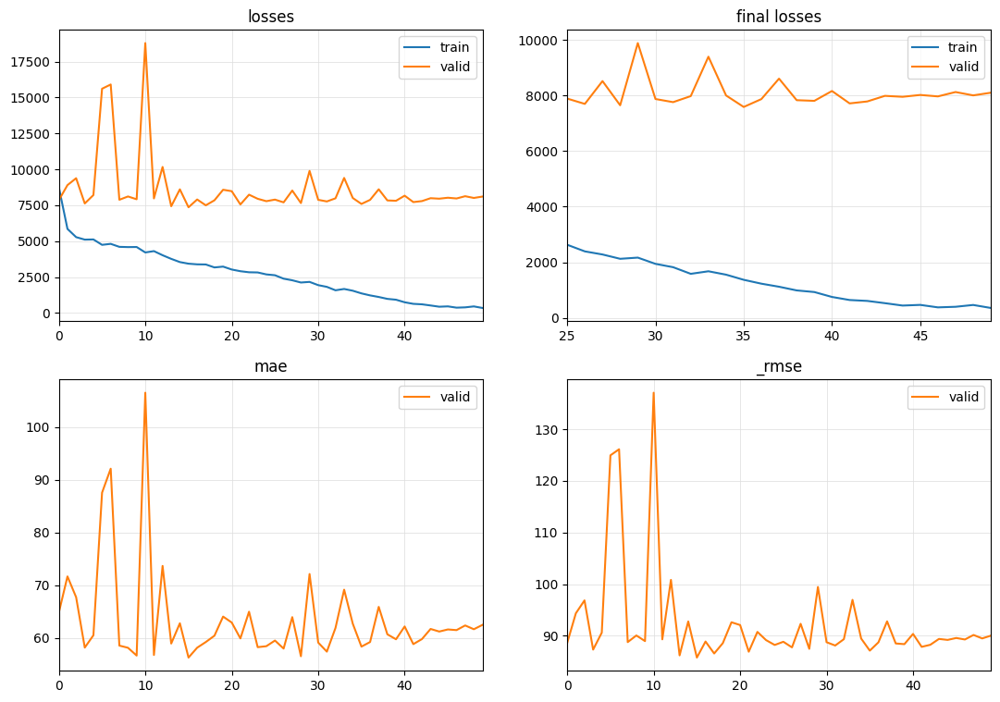

In [51]:
learn = ts_learner(dls, InceptionTime, metrics=[mae, rmse], cbs=ShowGraph())
learn.fit_one_cycle(50, 1e-1)

In [52]:
# Inference #
probas, _, preds = learn.get_X_preds(X[splits[1]])
skm.mean_squared_error(y[splits[1]], preds, squared=False)

90.03599556029158

# 4.Darts （需要转换对应的数据格式且不能有日期序列不能有缺失/重复值，麻烦）

## 4.1 build TS from df

In [7]:
from darts import TimeSeries

In [8]:
def trsfm2ts(mob_w_ref):
    """将某一帧的数据转为TimeSeries

    Args:
        mob_w_ref (dataframe): 带ref的某个LCS的完整数据帧
    """
    mob_w_ref.time = pd.to_datetime(mob_w_ref.time)
    mob_w_ref.set_index('time', inplace=True)
    mob_f = mob_w_ref[~mob_w_ref.index.duplicated()] # 去重
    return TimeSeries.from_dataframe(mob_f, value_cols='pm2d5', freq='T') # 转成TimeSeries类型，会自动填充缺失日期 #


In [9]:
ts_mob = trsfm2ts(mob_w_ref[5])

## 4.2 filtering

In [42]:
from darts.models import KalmanFilter
# 缺失值似乎没法用 # 
kf = KalmanFilter(dim_x=3)
kf.fit(ts_mob)
filtered_series = kf.filter(ts_mob, num_samples=100)

ts_mob.plot()
filtered_series.plot()

ValueError: Output data cannot contain nulls

In [10]:
from darts.models import MovingAverageFilter

avg = MovingAverageFilter(5)

filtered_series = avg.filter(ts_mob)


In [19]:
filtered_mob = filtered_series.pd_dataframe()
filtered_mob = filtered_mob.reset_index()

In [31]:
filtered_mob

component,time,rolling_mean_5_pm2d5
0,2022-04-01 05:11:00,35.140470
1,2022-04-01 05:12:00,34.934227
2,2022-04-01 05:13:00,35.410582
3,2022-04-01 05:14:00,36.462900
4,2022-04-01 05:15:00,36.444600
...,...,...
350109,2022-11-30 08:20:00,9.100200
350110,2022-11-30 08:21:00,8.890100
350111,2022-11-30 08:22:00,8.252447
350112,2022-11-30 08:23:00,8.198809


# 5.NeuralForecast

In [39]:
import pandas as pd
from neuralforecast import NeuralForecast
from neuralforecast.models import *
from neuralforecast.losses.pytorch import *

In [40]:
def tsfm_data(mob_w_ref, idx):
    """转换移动LCS的原始读数序列(含部分ref标签)为模型输入需要的格式['ds','unique','y']

    Args:
        mob_w_ref (dataframe): 移动LCS的原始读数序列(含部分ref标签)
        idx (int): LCS tag number

    Returns:
        dataframe: 转换好的数据帧
    """
    df = mob_w_ref[idx].loc[:, ['time', 'pm2d5']]
    df['unique_id'] = idx
    df.rename(columns={'time': 'ds', 'pm2d5': 'y'}, inplace=True)
    df['ds'] = pd.to_datetime(df['ds'])
    df.drop_duplicates(subset='ds', inplace=True) # 必须去重，否则填充时间戳时冲突报错
    return df

In [41]:
from utilsforecast.preprocessing import fill_gaps

def fill_data(df):
    """ 填充转换后的数据帧(得保证时间戳是唯一不重复的)

    Args:
        df (dataframe): transformed df from LCS

    Returns:
        df: filled df
    """
    df_filled = fill_gaps(df, freq='min')
    df_filled.fillna(0, inplace=True)
    df_filled['available_mask'] = False
    df_filled.loc[df_filled['y'] > 0, 'available_mask'] = True
    return df_filled

In [43]:
def FittingModel(ts):
      """ create NeuralForecast Models and fit them to the given ts

      Args:
          ts (dataframe): transformed and filled dataframe to be fitted

      Returns:
          NeuralForecast: fitted instantiated NeuralForecast class
      """

      horizon = 1

      models = [
            # TimesNet(h=horizon,
            #       input_size=24,
            #       hidden_size = 16,
            #       conv_hidden_size = 32,
            #       loss=MAE(),
            #       #loss=MQLoss(quantiles=[0.2, 0.5, 0.8]),
            #       #loss=DistributionLoss(distribution='Normal', level=[80, 90]),
            #       # futr_exog_list=calendar_cols,
            #       scaler_type='standard',
            #       learning_rate=1e-3,
            #       max_steps=100,
            #       val_check_steps=50,
            #       early_stop_patience_steps=2,
            #       accelerator="cuda", devices=[1]),
            # NHITS(h=horizon,                   # Forecast horizon
            #       input_size=10 * horizon,      # Length of input sequence
            #       max_steps=100,               # Number of steps to train
            #       n_freq_downsample=[2, 1, 1], # Downsampling factors for each stack output
            #       accelerator="cuda", devices=[1]),
            TFT(h=horizon, input_size=16,
                hidden_size=20,
                #loss=DistributionLoss(distribution='Poisson', level=[80, 90]),
                #loss=DistributionLoss(distribution='Normal', level=[80, 90]),
                loss=DistributionLoss(distribution='StudentT', level=[80, 90]),
                learning_rate=0.005,
                # stat_exog_list=['airline1'],
                #futr_exog_list=['y_[lag12]'],
                # hist_exog_list=['trend'],
                max_steps=100,
                val_check_steps=20,
                early_stop_patience_steps=10,
                scaler_type='robust',
                windows_batch_size=None,
                enable_progress_bar=True,
                accelerator="cuda", devices=[1]),
            ]
      
      nf = NeuralForecast(models=models, freq='min')
      nf.fit(df=ts, val_size=12)
      return nf


In [42]:
# 为什么超参数一致情况下每次训练的结果一样呢？ 因为固定了随机种子，所以权值初始化的内容每次都固定了，所以不改变超参数和数据那结果就是相应固定的。这是必要的做法
# 详情见知乎：https://www.zhihu.com/question/387033253   https://www.zhihu.com/question/345043149  
# nf.models[0].valid_trajectories

[(0, 6.008116245269775), (50, 4.925430774688721), (100, 4.135789394378662)]

In [55]:
Y_hat_insample = []
vehicle_n = 22
for i in range(vehicle_n):
    if i == 17:
        nf = FittingModel(fill_data(tsfm_data(mob_w_ref, i)))
        Y_hat_insample.append(nf.predict_insample()) 

Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

In [52]:
Y_hat_insample[0]



,unique_id,ds,cutoff,TFT,TFT-median,TFT-lo-90,TFT-lo-80,TFT-hi-80,TFT-hi-90,y
0,12,2022-04-01 07:26:00,2022-04-01 07:25:00,-0.071719,-0.042728,-1.398774,-0.977800,0.851771,1.179165,16.533001
1,12,2022-04-01 07:27:00,2022-04-01 07:26:00,17.394073,17.313032,6.788448,10.806809,24.481213,27.149567,42.400501
2,12,2022-04-01 07:28:00,2022-04-01 07:27:00,33.072170,34.324409,-13.720716,3.490936,62.586693,76.145775,44.854500
3,12,2022-04-01 07:29:00,2022-04-01 07:28:00,43.945423,44.018517,27.081684,33.069286,55.907112,61.026779,43.513157
4,12,2022-04-01 07:30:00,2022-04-01 07:29:00,43.797764,43.521820,39.096672,40.207924,47.184715,49.395111,43.566502
...,...,...,...,...,...,...,...,...,...,...
350910,12,2022-11-30 23:56:00,2022-11-30 23:55:00,13.687302,13.728812,11.425242,12.172519,15.223925,15.816553,16.299500
350911,12,2022-11-30 23:57:00,2022-11-30 23:56:00,14.981504,14.998382,11.519418,12.667483,17.407698,18.620461,13.516500
350912,12,2022-11-30 23:58:00,2022-11-30 23:57:00,13.618677,13.694647,10.798785,11.831831,15.539303,16.462564,13.517000
350913,12,2022-11-30 23:59:00,2022-11-30 23:58:00,13.469315,13.657813,11.302039,12.031893,15.252913,15.881730,16.183500


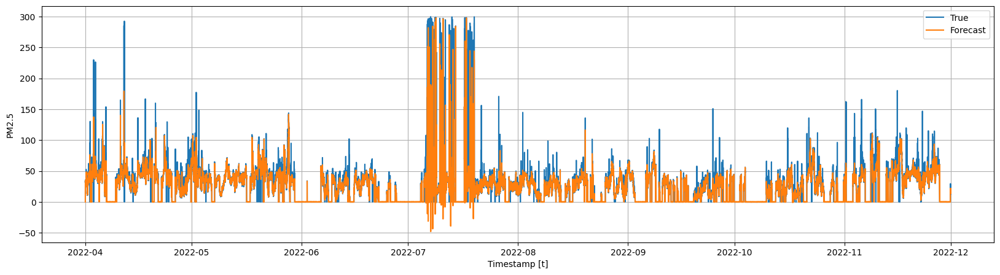

In [50]:
import matplotlib.pyplot as plt

plt.figure(figsize=(20, 5))
plt.plot(Y_hat_insample[0]['ds'], Y_hat_insample[0]['y'], label='True')
plt.plot(Y_hat_insample[0]['ds'], Y_hat_insample[0]['TFT'], label='Forecast')
# plt.axvline(Y_hat_insample['ds'].iloc[-12], color='black', linestyle='--', label='Train-Test Split')
plt.xlabel('Timestamp [t]')
plt.ylabel('PM2.5')
plt.grid()
plt.legend()


# 6.PYOD

In [20]:
from pyod.models.ecod import ECOD
from pyod.models.abod import ABOD
from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.mcd import MCD
from pyod.models.ocsvm import OCSVM
from pyod.models.pca import PCA
from pyod.models.lscp import LSCP
from pyod.models.inne import INNE
from pyod.models.gmm import GMM
from pyod.models.kde import KDE
from pyod.models.lmdd import LMDD

In [22]:
from sklearn.model_selection import train_test_split

def anomaly(clf, train, test):
    clf.fit(train)
    y_test_pred = clf.predict(test) 
    y_test_scores = clf.decision_function(test)
    
    return y_test_pred, y_test_scores

In [29]:
# # train kNN detector
# clf_name = 'KNN'
# clf = KNN() # 默认的异常率是0.1
# clf.fit(train)

# # get the prediction labels and outlier scores of the training data
# y_train_pred = clf.labels_  # binary labels (0: inliers, 1: outliers)
# y_train_scores = clf.decision_scores_  # raw outlier scores

# # get the prediction on the test data
# # y_test_pred = clf.predict(train)  # outlier labels (0 or 1)
# # y_test_scores = clf.decision_function(train)  # outlier scores

# # it is possible to get the prediction confidence as well
# y_test_pred, y_test_pred_confidence = clf.predict(train, return_confidence=True)  # outlier labels (0 or 1) and confidence in the range of [0,1]

In [21]:
# KNN
# 组合？
clf = KNN(n_neighbors=10, method='mean')
for i, df in enumerate(mob_w_ref):
    clf.fit(df[['pm2d5','hmd','tmp', 'lat', 'lon']]) # mob_w_ref[i][['pm2d5','hmd','tmp', 'lat', 'lon']]
    y_train_pred = clf.labels_  # binary labels (0: inliers, 1: outliers)
    y_train_scores = clf.decision_scores_  # raw outlier scores
    df['train_score'] = y_train_scores
    df['error'] = abs(df['ref_pm2d5'] - df['pm2d5'])
    pcc = df['train_score'].corr(df['error'])
    if i in mob_selected:
        print("lcs{}'s pcc: {}".format(i, pcc))

lcs0's pcc: 0.1681683535166831
lcs1's pcc: 0.15580752641814877
lcs2's pcc: 0.020862869144511596
lcs3's pcc: 0.2368234759448153
lcs4's pcc: 0.18483145778615154
lcs7's pcc: 0.17704721898158982
lcs10's pcc: 0.5455849268197044
lcs11's pcc: 0.06845077363217333
lcs12's pcc: 0.3335571683260511
lcs16's pcc: 0.16633691641784176
lcs17's pcc: 0.49842952496120185


In [23]:
# 划分训练/测试
clf = KNN(n_neighbors=10, method='mean')
for i in range(22):
    train, test = train_test_split(mob_w_ref[i], test_size=0.3, random_state=42)
    test_pred, test_scores = anomaly(clf, train[['pm2d5','hmd','tmp', 'lat', 'lon']], test[['pm2d5','hmd','tmp', 'lat', 'lon']]) # mob_w_ref[i][['pm2d5','hmd','tmp', 'lat', 'lon']]
    test['train_score'] = test_scores
    test['error'] = abs(test['ref_pm2d5'] - test['pm2d5'])
    pcc = test['train_score'].corr(test['error'])
    if i in mob_selected:
        print("lcs{}'s pcc: {}".format(i, pcc))

lcs0's pcc: 0.22608042704845938
lcs1's pcc: 0.17973695922879376
lcs2's pcc: 0.001584536689922424
lcs3's pcc: 0.20776720546795974
lcs4's pcc: 0.2214581453433623
lcs5's pcc: 0.2900197372435964
lcs6's pcc: -0.7222090362301712
lcs7's pcc: 0.1886170619726007
lcs8's pcc: 0.3590519783269606
lcs9's pcc: 0.6077891942663994
lcs10's pcc: 0.46509508687256723
lcs11's pcc: 0.15946627433131585
lcs12's pcc: 0.3317661454207504
lcs13's pcc: 0.4271072072864304
lcs14's pcc: 0.7615266968361718
lcs15's pcc: 0.4006856215137938
lcs16's pcc: 0.1425343609988195
lcs17's pcc: 0.5481180815941569
lcs18's pcc: 0.5085690380712065
lcs19's pcc: 0.16143669611305841
lcs20's pcc: 0.3050216969984962
lcs21's pcc: 0.2381856389907298


In [31]:
vis = mob_w_ref[13]['train_score']
vis

0        2.029164
1        1.286129
2        1.294931
3        1.239767
4        1.160992
           ...   
88683    1.157787
88684    1.053656
88685    1.004339
88686    1.017360
88687    1.016076
Name: train_score, Length: 88688, dtype: float64

In [33]:
from plotly import graph_objects as go

fig = go.Figure()

## 描出所有resample数据

# fig.add_trace(  
#         dict(name="error", 
#         showlegend=True),  ## 没有的话legend不显示       
#         hf_x=tmp.time,
#         hf_y=df_scaled.error)

# fig.add_trace(  
#         dict(name="anomaly_score", 
#         showlegend=True),  ## 没有的话legend不显示       
#         hf_x=tmp.time,
#         hf_y=df_scaled.train_score)
tmp = mob_w_ref[12]# [~mob_w_ref[5]['error'].isna()]

fig.add_trace(go.Scatter(x=tmp.error, y=tmp.train_score, mode='markers', name='error-anomaly'))


fig.update_layout(
            title_text="error-anomaly", #Add a chart title·
            title_font_family="Times New Roman",
            title_font_size = 20,
            title_font_color="darkblue", #Specify font color of the title
            title_x=0.5, #Specify the title position
            yaxis_title='anomaly_score',
            xaxis_title='error'
            # legend=dict(orientation="h", y=1.1, xanchor="left", x=0)
            )


fig

In [49]:
from plotly import graph_objects as go

fig = go.Figure()

## 描出所有resample数据

tmp = mob_w_ref[14][~mob_w_ref[14]['error'].isna()] # 必须是含标签的数据
# Manual Min-Max scaling with pandas
df_scaled = (tmp[['train_score', 'error']] - tmp[['train_score', 'error']].min()) / (tmp[['train_score', 'error']].max() - tmp[['train_score', 'error']].min())
# Manual standardization with pandas
# df_scaled= (tmp[['train_score', 'error']] - tmp[['train_score', 'error']].mean()) / tmp[['train_score', 'error']].std()


fig.add_trace(go.Scatter(x=tmp.time, y=df_scaled.error, mode='markers+lines', name='error'))
fig.add_trace(go.Scatter(x=tmp.time, y=df_scaled.train_score, mode='markers+lines', name='anomaly_score'))


fig.update_layout(
            title_text="error-anomaly", #Add a chart title·
            title_font_family="Times New Roman",
            title_font_size = 20,
            title_font_color="darkblue", #Specify font color of the title
            title_x=0.5, #Specify the title position
            legend=dict(orientation="h", y=1.1, xanchor="left", x=0)
            )


fig

# 8.AlibiDetect

## 8.1 SpectralResidual

The algorithm first computes the Fourier Transform of the original data. Then it computes the spectral residual of the log amplitude of the transformed signal before applying the Inverse Fourier Transform to map the sequence back from the frequency to the time domain

In [22]:
from alibi_detect.od import SpectralResidual

od = SpectralResidual(
    threshold=1.,
    window_amp=100,
    window_local=100,
    padding_amp_method='reflect',
    padding_local_method='reflect',
    padding_amp_side='bilateral',
    n_est_points=10,
    n_grad_points=5
)

2024-01-17 14:26:36.106180: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-01-17 14:26:36.370441: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-17 14:26:37.391737: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [37]:
preds = od.predict(
    mob_w_ref[11]['pm2d5'][3000:4000].values,
    # t=t,  # array with timesteps, assumes dt=1 between observations if omitted
    return_instance_score=True
)

In [38]:
df = mob_w_ref[11][3000:4000].copy()
df['train_score'] = preds['data']['instance_score']
df['error'] = abs(df['ref_pm2d5'] - df['pm2d5'])
pcc = df['train_score'].corr(df['error'])
pcc

-0.8454270658012301

In [103]:
from plotly import graph_objects as go

fig = go.Figure()

## 描出所有resample数据

tmp = mob_w_ref[13][~mob_w_ref[13]['error'].isna()] # 必须是含标签的数据
# Manual Min-Max scaling with pandas
df_scaled = (tmp[['train_score', 'error']] - tmp[['train_score', 'error']].min()) / (tmp[['train_score', 'error']].max() - tmp[['train_score', 'error']].min())
# Manual standardization with pandas
# df_scaled= (tmp[['train_score', 'error']] - tmp[['train_score', 'error']].mean()) / tmp[['train_score', 'error']].std()


fig.add_trace(go.Scatter(x=tmp.time, y=df_scaled.error, mode='markers+lines', name='error'))
fig.add_trace(go.Scatter(x=tmp.time, y=df_scaled.train_score, mode='markers+lines', name='anomaly_score'))


fig.update_layout(
            title_text="error-anomaly", #Add a chart title·
            title_font_family="Times New Roman",
            title_font_size = 20,
            title_font_color="darkblue", #Specify font color of the title
            title_x=0.5, #Specify the title position
            legend=dict(orientation="h", y=1.1, xanchor="left", x=0)
            )


fig

In [89]:
pcc

0.26748297223421597

## 8.2 Seq2Seq

In [199]:
from alibi_detect.od import OutlierSeq2Seq

n_features = 2  # number of features in the time series
seq_len = 50  # sequence length

od = OutlierSeq2Seq(n_features,
                    seq_len,
                    threshold=None,
                    backend='pytorch',
                    latent_dim=100)

    # train
od.fit(ref[9]['pm2d5'],
        epochs=10,
        verbose=False)

ImportError: Attempted to use OutlierSeq2Seq without the correct optional dependencies installed. To install the correct optional dependencies, run `pip install alibi-detect[tensorflow]` from the command line. For more information, check the Installation documentation at https://docs.seldon.io/projects/alibi-detect/en/stable/overview/getting_started.html.

In [ ]:
od_preds = od.predict(X_outlier,
                      outlier_type='instance',    # use 'feature' or 'instance' level
                      return_feature_score=True,  # scores used to determine outliers
                      return_instance_score=True)

# Evaluation

In [48]:
def display_stats(i, Y_hat_insample, ref, entry:str, err_prcnt = 0.2, err_abs = 10):
    """output LCS error stats

    Args:
        i (int): # of LCS
        filtered_mob (df): df transformed back from TimeSeries
        ref (df): 带ref的LCS数据帧
        entry: str, the model inferred column to be tested
    """
    filtered_mob = Y_hat_insample.rename(columns={'ds': 'time'}).drop(columns=['cutoff', 'y'])
    ref['time'] = pd.to_datetime(ref['time'])
    avg_mob = pd.merge(ref, filtered_mob, on='time')
    avg_mob['error'] = abs(avg_mob[entry] - avg_mob['ref_pm2d5'])
    avg_mob['error_%'] = abs(avg_mob['error']) / avg_mob['ref_pm2d5']
    avg_mob.dropna(inplace=True)
    
    
    error_size = len(avg_mob['error_%'][avg_mob['error_%'] > err_prcnt])
    error_tot = len(avg_mob)
    print('lcs{}: {}'.format(i, avg_mob['error'].mean(numeric_only=True)) +
            ', and {}/{} ({}%) points have {}% more error'.format(error_size, error_tot, int(error_size/error_tot * 100), err_prcnt * 100) +
            ', and {}/{} ({}%) points have {} more error'.format(len(avg_mob['error'] [avg_mob['error'] > err_abs] ),
                                                                    error_tot, int(len(avg_mob[avg_mob['error'] > err_abs])/error_tot * 100), err_abs)
            )

In [48]:
# lcs5(14.03): AutoArima - 13.85, HoltWinters - 14.62, SESO(简单指数平滑) - 14.59 #
# lcs8(12.11): AutoArima - 12.15, AutoRegressive - 12.78，autoCES - 12.06, AutoETS - 12.28, AutoTheta - 12.17, RWD - 12.24, GARCH(1,1) - 22.63  #
# display_stats(14, Y_hat_insample[14], rndzvs_df[14], 'TFT', 0.1)

lcs14: 13.312743484704065, and 1250/1415 (88%) points have 10.0% more error, and 754/1415 (53%) points have 10 more error


lcs11(label: 7437/234926, 3.17%): MAE 12.11, RMSE 15.01, PCC 0.70, mape 0.85, wmape 0.60, and 6665/7437 (89%) points have 10.0% more error, and 3832/7437 (51%) points have 10 more error

lcs12(label: 33849/201440, 16.80%): MAE 9.26, RMSE 12.29, PCC 0.73, mape 0.54, wmape 0.42, and 28311/33849 (83%) points have 10.0% more error, and 12541/33849 (37%) points have 10 more error

lcs17(label: 1049/177402, 0.59%): MAE 11.66, RMSE 14.44, PCC 0.77, mape 0.70, wmape 0.54, and 931/1049 (88%) points have 10.0% more error, and 569/1049 (54%) points have 10 more error

lcs7(label: 211/161415, 0.13%): MAE 18.57, RMSE 21.30, PCC 0.57, mape 1.03, wmape 0.86, and 209/211 (99%) points have 10.0% more error, and 159/211 (75%) points have 10 more error

lcs16(label: 8863/150169, 5.90%): MAE 8.59, RMSE 11.17, PCC 0.58, mape 0.47, wmape 0.36, and 7259/8863 (81%) points have 10.0% more error, and 2994/8863 (33%) points have 10 more error

lcs4(label: 1889/122854, 1.54%): MAE 12.82, RMSE 16.22, PCC 0.66, mape 0.89, wmape 0.60, and 1685/1889 (89%) points have 10.0% more error, and 1037/1889 (54%) points have 10 more error

lcs2(label: 5306/116746, 4.54%): MAE 8.81, RMSE 12.67, PCC 0.58, mape 0.45, wmape 0.36, and 4335/5306 (81%) points have 10.0% more error, and 1815/5306 (34%) points have 10 more error

lcs3(label: 5882/114479, 5.14%): MAE 9.04, RMSE 11.70, PCC 0.74, mape 0.48, wmape 0.36, and 4809/5882 (81%) points have 10.0% more error, and 2188/5882 (37%) points have 10 more error

lcs1(label: 3968/117475, 3.38%): MAE 8.30, RMSE 10.56, PCC 0.67, mape 0.52, wmape 0.41, and 3330/3968 (83%) points have 10.0% more error, and 1298/3968 (32%) points have 10 more error

lcs0(label: 5454/106713, 5.11%): MAE 9.87, RMSE 16.01, PCC 0.62, mape 0.52, wmape 0.38, and 4488/5454 (82%) points have 10.0% more error, and 2102/5454 (38%) points have 10 more error

lcs10(label: 7163/104740, 6.84%): MAE 9.86, RMSE 13.58, PCC 0.62, mape 0.63, wmape 0.43, and 5997/7163 (83%) points have 10.0% more error, and 2898/7163 (40%) points have 10 more error

In [56]:

display_stats(17, Y_hat_insample[0], rndzvs_df[17], 'TFT', 0.1)

lcs17: 11.260626019299684, and 944/1049 (89%) points have 10.0% more error, and 563/1049 (53%) points have 10 more error


In [14]:
for i in range(vehicle_n):
    display_stats(i, Y_hat_insample[i], rndzvs_df[i], 'TFT', 0.1)



lcs0: 9.71643670941254, and 4489/5454 (82%) points have 10.0% more error, and 2026/5454 (37%) points have 10 more error
lcs1: 8.270407744164007, and 3353/3968 (84%) points have 10.0% more error, and 1288/3968 (32%) points have 10 more error
lcs2: 8.709372063183523, and 4289/5306 (80%) points have 10.0% more error, and 1750/5306 (32%) points have 10 more error
lcs3: 8.934104391907722, and 4797/5882 (81%) points have 10.0% more error, and 2155/5882 (36%) points have 10 more error
lcs4: 12.797381406019705, and 1679/1889 (88%) points have 10.0% more error, and 1033/1889 (54%) points have 10 more error
lcs5: 14.021665761961268, and 908/979 (92%) points have 10.0% more error, and 581/979 (59%) points have 10 more error
lcs6: 22.86420444064669, and 27/27 (100%) points have 10.0% more error, and 27/27 (100%) points have 10 more error
lcs7: 18.867346936221374, and 208/211 (98%) points have 10.0% more error, and 158/211 (74%) points have 10 more error
lcs8: 11.12090210720079, and 4834/5268 (91%)

In [15]:
# 计算所有LCS平均误差 #
# original - 10.06, NHITS - 10.00, TimesNet - 9.88, TFT - 9.798#
sum_err = 0
n = 0
for i in range(vehicle_n):
    filtered_mob = Y_hat_insample[i].rename(columns={'ds': 'time'}).drop(columns=['cutoff', 'y'])
    rndzvs_df[i]['time'] = pd.to_datetime(rndzvs_df[i]['time'])
    avg_mob = pd.merge(rndzvs_df[i], filtered_mob, on='time')
    avg_mob['error'] = abs(avg_mob['TFT'] - avg_mob['ref_pm2d5'])
    sum_err += abs(avg_mob['error']).sum()
    n += len(rndzvs_df[i])
print(sum_err / n)

9.79811453959518


In [ ]:
# 计算筛选LCS的平均误差 #
sum_err = 0
n = 0
mob_selected = [11, 12, 17, 7, 16, 4, 2, 3, 1, 0, 10]
for val, i in enumerate(mob_selected):
    filtered_mob = Y_hat_insample[i].rename(columns={'ds': 'time'}).drop(columns=['cutoff', 'y'])
    rndzvs_df[i]['time'] = pd.to_datetime(rndzvs_df[i]['time'])
    avg_mob = pd.merge(rndzvs_df[i], filtered_mob, on='time')
    avg_mob['error'] = abs(avg_mob['TFT'] - avg_mob['ref_pm2d5'])
    sum_err += abs(avg_mob['error']).sum()
    n += len(rndzvs_df[i])
print(sum_err / n)